# <center> Caso Sentimientos en Twitter | Analysis and Visualization </center>

1. [Import libraries](#impo_lib)
2. [Data reading](#data_rea)
3. [Analyses](#data_ana)
3. [Visualization](#data_vis)

### 1. Import libraries <a id = "imp_lib">*</a>

In [114]:
import pandas as pd
import numpy as np

from sklearn import preprocessing 
from sklearn.preprocessing import OneHotEncoder
from sklearn.model_selection import train_test_split
from sklearn.cluster import KMeans
from sklearn.metrics import mean_squared_error, accuracy_score
from sklearn.tree import DecisionTreeRegressor, DecisionTreeClassifier
from sklearn.ensemble import RandomForestRegressor
from sklearn.linear_model import LinearRegression, LogisticRegression, RidgeCV
from sklearn.svm import LinearSVR
from lightgbm import LGBMRegressor

from afinn import Afinn #hacer heatmap
import neattext as nt 
import textstat

from wordcloud import WordCloud, ImageColorGenerator
import nltk
from nltk.corpus import stopwords

import re
from nltk import word_tokenize
from unidecode import unidecode

from scipy import stats

import datetime
import plotly.express as px
import plotly.graph_objects as go
import seaborn as sns
import matplotlib.pyplot as plt

pd.options.display.float_format = '{:.4f}'.format

In [49]:
import warnings
warnings.filterwarnings("ignore")

### 2. Data reading <a id = "data_red">*</a>

In [50]:
df =pd.read_csv("Data/tweet_full.csv", engine= 'python', encoding='utf-8', error_bad_lines=False, header=None)
df = df.drop(0, axis=1)
df.head(10)

Skipping line 182574: unexpected end of data


,1,2,3,4,5
0,1467810369,Mon Apr 06 22:19:45 PDT 2009,NO_QUERY,_TheSpecialOne_,"@switchfoot http://twitpic.com/2y1zl - Awww, t..."
1,1467810672,Mon Apr 06 22:19:49 PDT 2009,NO_QUERY,scotthamilton,is upset that he can't update his Facebook by ...
2,1467810917,Mon Apr 06 22:19:53 PDT 2009,NO_QUERY,mattycus,@Kenichan I dived many times for the ball. Man...
3,1467811184,Mon Apr 06 22:19:57 PDT 2009,NO_QUERY,ElleCTF,my whole body feels itchy and like its on fire
4,1467811193,Mon Apr 06 22:19:57 PDT 2009,NO_QUERY,Karoli,"@nationwideclass no, it's not behaving at all...."
5,1467811372,Mon Apr 06 22:20:00 PDT 2009,NO_QUERY,joy_wolf,@Kwesidei not the whole crew
6,1467811592,Mon Apr 06 22:20:03 PDT 2009,NO_QUERY,mybirch,Need a hug
7,1467811594,Mon Apr 06 22:20:03 PDT 2009,NO_QUERY,coZZ,@LOLTrish hey long time no see! Yes.. Rains a...
8,1467811795,Mon Apr 06 22:20:05 PDT 2009,NO_QUERY,2Hood4Hollywood,@Tatiana_K nope they didn't have it
9,1467812025,Mon Apr 06 22:20:09 PDT 2009,NO_QUERY,mimismo,@twittera que me muera ?


In [51]:
#ponemos nombre a las columnas
df.columns=['Id del tweet', 'Fecha del tweet', 'Búsqueda', 'Usuario', 'Texto']

In [52]:
df.head()

,Id del tweet,Fecha del tweet,Búsqueda,Usuario,Texto
0,1467810369,Mon Apr 06 22:19:45 PDT 2009,NO_QUERY,_TheSpecialOne_,"@switchfoot http://twitpic.com/2y1zl - Awww, t..."
1,1467810672,Mon Apr 06 22:19:49 PDT 2009,NO_QUERY,scotthamilton,is upset that he can't update his Facebook by ...
2,1467810917,Mon Apr 06 22:19:53 PDT 2009,NO_QUERY,mattycus,@Kenichan I dived many times for the ball. Man...
3,1467811184,Mon Apr 06 22:19:57 PDT 2009,NO_QUERY,ElleCTF,my whole body feels itchy and like its on fire
4,1467811193,Mon Apr 06 22:19:57 PDT 2009,NO_QUERY,Karoli,"@nationwideclass no, it's not behaving at all...."


| Name | ProbDistribution | 
| --- | --- | 
| 	Polaridad | Puntuación sentimental o polaridad (negativa, neutral, positiva) (por calcular) | 
| Id del tweet | Identidficación del tweet  | 
| Fecha del tweet | Fecha del tweet (Sat May 16 23:58:44 UTC 2009)| 
| Búsqueda | Tweet resultado de una búsqueda. Si no hay búsqueda, el valor es NO_QUERY | 
| Usuario | Usuario que ha tweeteado | 


### 3. Analysis <a id = "data_ana">*</a>

#### 1. Calcula la polaridad de cada tweet y su índice de legibilidad. Muestra una tabla resumen del dataset solo de aquellos 10 tweets que un estudiante de 3ºESO pueda entender, ordenados por legibilidad de mayor a menor, mostrando los 5 primeros tweets de mayor legibilidad y los 5 últimos tweets de menor legibilidad

In [53]:
print(f"Número de nulos: {df.Texto.isna().sum()}")

Número de nulos: 0


In [54]:
#añadimos la columna 'Scores' que nos dará la polaridad
afn = Afinn()
df["Scores"] = df.Texto.apply(afn.score)
df.head()

,Id del tweet,Fecha del tweet,Búsqueda,Usuario,Texto,Scores
0,1467810369,Mon Apr 06 22:19:45 PDT 2009,NO_QUERY,_TheSpecialOne_,"@switchfoot http://twitpic.com/2y1zl - Awww, t...",-2.0000
1,1467810672,Mon Apr 06 22:19:49 PDT 2009,NO_QUERY,scotthamilton,is upset that he can't update his Facebook by ...,-5.0000
2,1467810917,Mon Apr 06 22:19:53 PDT 2009,NO_QUERY,mattycus,@Kenichan I dived many times for the ball. Man...,2.0000
3,1467811184,Mon Apr 06 22:19:57 PDT 2009,NO_QUERY,ElleCTF,my whole body feels itchy and like its on fire,-2.0000
4,1467811193,Mon Apr 06 22:19:57 PDT 2009,NO_QUERY,Karoli,"@nationwideclass no, it's not behaving at all....",-4.0000


In [55]:
# A partir de Scores calculamos la polaridad (positivo, neutro, negativo)
def polaridad(Scores):
  if Scores <-1:
    return 'negative'
  elif Scores >1:
    return 'positive'
  else:
    return 'neutral'

df["Polaridad"] = df.Scores.apply(lambda x: polaridad(x))
df.head()

,Id del tweet,Fecha del tweet,Búsqueda,Usuario,Texto,Scores,Polaridad
0,1467810369,Mon Apr 06 22:19:45 PDT 2009,NO_QUERY,_TheSpecialOne_,"@switchfoot http://twitpic.com/2y1zl - Awww, t...",-2.0000,negative
1,1467810672,Mon Apr 06 22:19:49 PDT 2009,NO_QUERY,scotthamilton,is upset that he can't update his Facebook by ...,-5.0000,negative
2,1467810917,Mon Apr 06 22:19:53 PDT 2009,NO_QUERY,mattycus,@Kenichan I dived many times for the ball. Man...,2.0000,positive
3,1467811184,Mon Apr 06 22:19:57 PDT 2009,NO_QUERY,ElleCTF,my whole body feels itchy and like its on fire,-2.0000,negative
4,1467811193,Mon Apr 06 22:19:57 PDT 2009,NO_QUERY,Karoli,"@nationwideclass no, it's not behaving at all....",-4.0000,negative


In [56]:
#Cálculo de la Legibilidad
df["Legibilidad"] = df.Texto.apply(textstat.dale_chall_readability_score)
df.head()

,Id del tweet,Fecha del tweet,Búsqueda,Usuario,Texto,Scores,Polaridad,Legibilidad
0,1467810369,Mon Apr 06 22:19:45 PDT 2009,NO_QUERY,_TheSpecialOne_,"@switchfoot http://twitpic.com/2y1zl - Awww, t...",-2.0000,negative,13.7300
1,1467810672,Mon Apr 06 22:19:49 PDT 2009,NO_QUERY,scotthamilton,is upset that he can't update his Facebook by ...,-5.0000,negative,7.9200
2,1467810917,Mon Apr 06 22:19:53 PDT 2009,NO_QUERY,mattycus,@Kenichan I dived many times for the ball. Man...,2.0000,positive,9.3500
3,1467811184,Mon Apr 06 22:19:57 PDT 2009,NO_QUERY,ElleCTF,my whole body feels itchy and like its on fire,-2.0000,negative,7.2900
4,1467811193,Mon Apr 06 22:19:57 PDT 2009,NO_QUERY,Karoli,"@nationwideclass no, it's not behaving at all....",-4.0000,negative,5.4900


In [57]:
# 4.9 or lower: average 4th-grade student or lower, based in library
def tercer_grado(Legibilidad):
  if Legibilidad < 4.9:
    return 'Entendible'
  else:
    return 'No entendible'

df["Entendible"] = df.Legibilidad.apply(lambda x: tercer_grado(x))
df.head()

,Id del tweet,Fecha del tweet,Búsqueda,Usuario,Texto,Scores,Polaridad,Legibilidad,Entendible
0,1467810369,Mon Apr 06 22:19:45 PDT 2009,NO_QUERY,_TheSpecialOne_,"@switchfoot http://twitpic.com/2y1zl - Awww, t...",-2.0000,negative,13.7300,No entendible
1,1467810672,Mon Apr 06 22:19:49 PDT 2009,NO_QUERY,scotthamilton,is upset that he can't update his Facebook by ...,-5.0000,negative,7.9200,No entendible
2,1467810917,Mon Apr 06 22:19:53 PDT 2009,NO_QUERY,mattycus,@Kenichan I dived many times for the ball. Man...,2.0000,positive,9.3500,No entendible
3,1467811184,Mon Apr 06 22:19:57 PDT 2009,NO_QUERY,ElleCTF,my whole body feels itchy and like its on fire,-2.0000,negative,7.2900,No entendible
4,1467811193,Mon Apr 06 22:19:57 PDT 2009,NO_QUERY,Karoli,"@nationwideclass no, it's not behaving at all....",-4.0000,negative,5.4900,No entendible


In [58]:
df_ent = df[df['Entendible'] == 'Entendible']
df_ent.head()

,Id del tweet,Fecha del tweet,Búsqueda,Usuario,Texto,Scores,Polaridad,Legibilidad,Entendible
6,1467811592,Mon Apr 06 22:20:03 PDT 2009,NO_QUERY,mybirch,Need a hug,2.0000,positive,0.1500,Entendible
25,1467814438,Mon Apr 06 22:20:44 PDT 2009,NO_QUERY,ChicagoCubbie,I hate when I have to call and wake people up,-3.0000,negative,0.5500,Entendible
54,1467821455,Mon Apr 06 22:22:32 PDT 2009,NO_QUERY,CiaraRenee,I need a hug,2.0000,positive,0.2000,Entendible
62,1467823437,Mon Apr 06 22:23:03 PDT 2009,NO_QUERY,xpika,The Life is cool. But not for Me.,1.0000,neutral,0.2000,Entendible
128,1467841832,Mon Apr 06 22:27:55 PDT 2009,NO_QUERY,bgoers,I'm so cold,0.0000,neutral,0.1500,Entendible


In [59]:
df_ent.sort_values('Legibilidad', ascending=False, inplace=True) 
df_ent.head(10)

,Id del tweet,Fecha del tweet,Búsqueda,Usuario,Texto,Scores,Polaridad,Legibilidad,Entendible
156157,1956045517,Thu May 28 21:05:05 PDT 2009,NO_QUERY,TrishwaH,Feeling thought make-up would help. now I jus...,3.0000,positive,4.8900,Entendible
109110,1824467340,Sun May 17 01:30:35 PDT 2009,NO_QUERY,chasingyou,Oh help me ! I can't study ! I've read the thi...,4.0000,positive,4.8900,Entendible
143097,1881641858,Fri May 22 05:12:07 PDT 2009,NO_QUERY,maryjane_,I AM SO EXHAUSTED!! I have to go to work stil...,-4.0000,negative,4.8900,Entendible
10930,1551116780,Sat Apr 18 08:11:37 PDT 2009,NO_QUERY,ginaharris1,@SKDickey Don't forget about the race! And how...,1.0000,neutral,4.8900,Entendible
30243,1563711408,Sun Apr 19 23:56:06 PDT 2009,NO_QUERY,eunen,Fuck. How hot is it tonight?! REALLY REALLY HO...,-6.0000,negative,4.8900,Entendible
93538,1770704966,Mon May 11 22:01:26 PDT 2009,NO_QUERY,JennyChang90,yes! I'm done with my essay...yet I still have...,1.0000,neutral,4.8900,Entendible
138984,1880696367,Fri May 22 02:10:10 PDT 2009,NO_QUERY,PsychoDuck,"Oh, right, it's because I feel like crap today...",0.0000,neutral,4.8900,Entendible
56378,1685384324,Sun May 03 00:09:32 PDT 2009,NO_QUERY,toddscottballje,This drive home suuuuucks! another hour to go...,1.0000,neutral,4.8900,Entendible
38033,1573150677,Mon Apr 20 23:55:39 PDT 2009,NO_QUERY,feeozgirl,Then off into the wide world. Wonder where we'...,2.0000,positive,4.8900,Entendible
163680,1958101472,Fri May 29 02:40:01 PDT 2009,NO_QUERY,eppsie,IS ANYONE AWAKE?!?!?!?! oh my god i am dying h...,-1.0000,neutral,4.8900,Entendible


#### 2. Analiza las frases de los tweets del dataset:

a. Número de frases totales.

b. Número de palabras distintas de más de 3 letras.

c. Máxima, mínima y media de longitud de las palabras.

d. La facilidad de lectura considerando las frases del tweet.

#### a. Número de frases totales.

In [60]:
df['Numero_frases']=df.Texto.apply(textstat.sentence_count)
print("El número de frases totales se muestra en nueva columna 'Numero_frases'")
df.head()

El número de frases totales se muestra en nueva columna 'Numero_frases'


,Id del tweet,Fecha del tweet,Búsqueda,Usuario,Texto,Scores,Polaridad,Legibilidad,Entendible,Numero_frases
0,1467810369,Mon Apr 06 22:19:45 PDT 2009,NO_QUERY,_TheSpecialOne_,"@switchfoot http://twitpic.com/2y1zl - Awww, t...",-2.0000,negative,13.7300,No entendible,2
1,1467810672,Mon Apr 06 22:19:49 PDT 2009,NO_QUERY,scotthamilton,is upset that he can't update his Facebook by ...,-5.0000,negative,7.9200,No entendible,2
2,1467810917,Mon Apr 06 22:19:53 PDT 2009,NO_QUERY,mattycus,@Kenichan I dived many times for the ball. Man...,2.0000,positive,9.3500,No entendible,2
3,1467811184,Mon Apr 06 22:19:57 PDT 2009,NO_QUERY,ElleCTF,my whole body feels itchy and like its on fire,-2.0000,negative,7.2900,No entendible,1
4,1467811193,Mon Apr 06 22:19:57 PDT 2009,NO_QUERY,Karoli,"@nationwideclass no, it's not behaving at all....",-4.0000,negative,5.4900,No entendible,3


#### b. Número de palabras distintas de más de 3 letras.

In [61]:
df['Numero_palabras'] = df.Texto.apply(textstat.lexicon_count, removepunct=True)
print("El número de palabras totales se muestra en nueva columna 'Numero_palabras'")
df.head()

El número de palabras totales se muestra en nueva columna 'Numero_palabras'


,Id del tweet,Fecha del tweet,Búsqueda,Usuario,Texto,Scores,Polaridad,Legibilidad,Entendible,Numero_frases,Numero_palabras
0,1467810369,Mon Apr 06 22:19:45 PDT 2009,NO_QUERY,_TheSpecialOne_,"@switchfoot http://twitpic.com/2y1zl - Awww, t...",-2.0000,negative,13.7300,No entendible,2,18
1,1467810672,Mon Apr 06 22:19:49 PDT 2009,NO_QUERY,scotthamilton,is upset that he can't update his Facebook by ...,-5.0000,negative,7.9200,No entendible,2,21
2,1467810917,Mon Apr 06 22:19:53 PDT 2009,NO_QUERY,mattycus,@Kenichan I dived many times for the ball. Man...,2.0000,positive,9.3500,No entendible,2,18
3,1467811184,Mon Apr 06 22:19:57 PDT 2009,NO_QUERY,ElleCTF,my whole body feels itchy and like its on fire,-2.0000,negative,7.2900,No entendible,1,10
4,1467811193,Mon Apr 06 22:19:57 PDT 2009,NO_QUERY,Karoli,"@nationwideclass no, it's not behaving at all....",-4.0000,negative,5.4900,No entendible,3,21


In [62]:
fig = px.histogram(df['Texto'].str.len(), 
                   nbins=20, 
                   labels={'value':'number of characters'},
                   title='Characterers per tweet',
                   opacity=0.8,
                   )
fig.show()

In [63]:
fig = px.histogram(df['Texto'].str.split().map( lambda x: len(x)), 
                   nbins=30, 
                   labels={'value':'number of words'},
                   title='Words per tweet',
                   opacity=0.8,
                   )
fig.show()

In [64]:
def string_k(str, k=3):
     
    string = []
    text = str.split(" ")
    for x in text:
        if len(x) > k:
            string.append(x)
    return string

serie_tmp = df['Texto'].apply(string_k)

In [65]:
serie_tmp

0         [@switchfoot, http://twitpic.com/2y1zl, Awww,,...
1         [upset, that, can't, update, Facebook, texting...
2         [@Kenichan, dived, many, times, ball., Managed...
3                   [whole, body, feels, itchy, like, fire]
4         [@nationwideclass, it's, behaving, all., mad.,...
                                ...                        
182568    [@TaliaRusso, miss, sugar!!, have, work, weeke...
182569                                               [road]
182570    [..omg, just, legit, offer, from, Activision, ...
182571    [getting, sick, missing, stunting, mats...i, w...
182572    [Happy, hell, finally, home., Bummed, missing,...
Name: Texto, Length: 182573, dtype: object

In [66]:
total_palabras=[]
for i in serie_tmp:

    total_palabras.append(i)

flat_list = []
for sublist in total_palabras:
    for item in sublist:
        flat_list.append(item)
        
len(list(dict.fromkeys(flat_list)))

229588

#### c. Máxima, mínima y media de longitud de las palabras.

In [67]:
var_temp = df['Numero_palabras']

print("---------------- LONGITUD MÁXIMA ----------------")
print (var_temp.max())
print(df.loc[var_temp.idxmax()])

print(f"\nTexto del Tweet más largo: {df.Texto.loc[var_temp.idxmax()]}")

---------------- LONGITUD MÁXIMA ----------------
35
Id del tweet                                              1753146505
Fecha del tweet                         Sun May 10 00:19:15 PDT 2009
Búsqueda                                                    NO_QUERY
Usuario                                               howareyoutoday
Texto              i hope so too  its got to be on a cd somewhere...
Scores                                                        2.0000
Polaridad                                                   positive
Legibilidad                                                   6.3100
Entendible                                             No entendible
Numero_frases                                                      2
Numero_palabras                                                   35
Name: 82714, dtype: object

Texto del Tweet más largo: i hope so too  its got to be on a cd somewhere. remember i put it on a cd for u to play at work a long time ago bt u said it didnt wo

In [68]:
print("---------------- LONGITUD MÍNIMA ----------------")
print (var_temp.min())
print(df.loc[var_temp.idxmax()])

print(f"\nTexto del Tweet más corto: {df.Texto.loc[var_temp.idxmin()]}")

---------------- LONGITUD MÍNIMA ----------------
1
Id del tweet                                              1753146505
Fecha del tweet                         Sun May 10 00:19:15 PDT 2009
Búsqueda                                                    NO_QUERY
Usuario                                               howareyoutoday
Texto              i hope so too  its got to be on a cd somewhere...
Scores                                                        2.0000
Polaridad                                                   positive
Legibilidad                                                   6.3100
Entendible                                             No entendible
Numero_frases                                                      2
Numero_palabras                                                   35
Name: 82714, dtype: object

Texto del Tweet más corto: Agh...snow!!! 


In [69]:
print(f"Longitud media de los Tweets: {var_temp.mean()}")
del var_temp

Longitud media de los Tweets: 13.448565779167785


In [70]:
fig = px.histogram(df['Texto'].str.split().apply(lambda x: [len(i) for i in x]). map(lambda x: np.mean(x)), 
                   labels={'value':'Average longitude of words per Tweet'},
                   title='Average longitude of words per Tweet',
                   opacity=0.8,
                   )
fig.show()

#### d. La facilidad de lectura considerando las frases del tweet.

In [71]:
df['lectura']=df.Texto.apply(textstat.automated_readability_index)


| Puntaje| Edad | Nivel de grado | 
| --- | --- | --- | 
1	|5-6	|Jardín de infancia
2	|6-7	|Primer grado
3	|7-8	|Segundo grado
4	|8-9	|Tercer grado
5	|9-10	|Cuarto grado
6	|10-11	|Quinto grado
7	|11-12	|Sexto grado
8	|12-13	|Séptimo grado
9	|13-14	|Octavo grado
10	|14-15	|Noveno grado
11	|15-16	|Décimo grado
12	|16-17	|Onceavo grado
13	|17-18	|duodécimo grado
14	|18-22	|Estudiante universitario

In [72]:
def Facilidad_lectura (lectura):
  if lectura >=13.5:
    return 'Estudiante universitario'
  elif 12.5<= lectura <13.5:
    return '12º grado'
  elif 11.5<= lectura <12.5:
    return '11º grado'
  elif 10.5<= lectura <11.5:
    return '10º grado'
  elif 9.5<= lectura <10.5:
    return '9º grado'
  elif 8.5<= lectura <9.5:
    return '8º grado'
  elif 7.5<= lectura <8.5:
    return '7º grado'
  elif 6.5<= lectura <7.5:
    return '6º grado'
  elif 5.5<= lectura <6.5:
    return '5º grado'
  elif 4.5<= lectura <5.5:
    return '4º grado'
  elif 3.5<= lectura <4.5:
    return '3er grado'
  elif 2.5<= lectura <3.5:
    return '2º grado'
  elif 1.5<= lectura <2.5:
    return '1er grado'
  else:
    return 'Jardín de infancia'

df["Nivel de grado"] = df.lectura.apply(lambda x: Facilidad_lectura(x))
df.head()

,Id del tweet,Fecha del tweet,Búsqueda,Usuario,Texto,Scores,Polaridad,Legibilidad,Entendible,Numero_frases,Numero_palabras,lectura,Nivel de grado
0,1467810369,Mon Apr 06 22:19:45 PDT 2009,NO_QUERY,_TheSpecialOne_,"@switchfoot http://twitpic.com/2y1zl - Awww, t...",-2.0000,negative,13.7300,No entendible,2,18,8.2000,7º grado
1,1467810672,Mon Apr 06 22:19:49 PDT 2009,NO_QUERY,scotthamilton,is upset that he can't update his Facebook by ...,-5.0000,negative,7.9200,No entendible,2,21,4.0000,3er grado
2,1467810917,Mon Apr 06 22:19:53 PDT 2009,NO_QUERY,mattycus,@Kenichan I dived many times for the ball. Man...,2.0000,positive,9.3500,No entendible,2,18,1.6000,1er grado
3,1467811184,Mon Apr 06 22:19:57 PDT 2009,NO_QUERY,ElleCTF,my whole body feels itchy and like its on fire,-2.0000,negative,7.2900,No entendible,1,10,1.0000,Jardín de infancia
4,1467811193,Mon Apr 06 22:19:57 PDT 2009,NO_QUERY,Karoli,"@nationwideclass no, it's not behaving at all....",-4.0000,negative,5.4900,No entendible,3,21,2.3000,1er grado


#### 3. Detecta los usuarios trolls mostrando los 10 primeros. Son trolls aquellos usuarios con un porcentaje de mensajes negativos superior al 75%

In [73]:
twetts_usuario = df.groupby('Usuario')['Id del tweet'].count().reset_index()
twetts_usuario.head()

,Usuario,Id del tweet
0,006jazzy,1
1,007_Chris_007,2
2,007buddha,1
3,007peter,2
4,007simple,1


In [74]:
twetts_negativos = df[df.Polaridad =='negative'].groupby('Usuario')['Id del tweet'].count().reset_index()
twetts_negativos.head()

,Usuario,Id del tweet
0,007_Chris_007,1
1,007buddha,1
2,007peter,1
3,00mouse2000,1
4,00soph00,1


In [75]:
twetts_total = twetts_usuario.merge(twetts_negativos,"inner", "Usuario", suffixes=['_total', '_negativos'])
twetts_total["Porcentage"] = twetts_total['Id del tweet_negativos'] / twetts_total['Id del tweet_total'] * 100
twetts_total

,Usuario,Id del tweet_total,Id del tweet_negativos,Porcentage
0,007_Chris_007,2,1,50.0000
1,007buddha,1,1,100.0000
2,007peter,2,1,50.0000
3,00mouse2000,2,1,50.0000
4,00soph00,1,1,100.0000
...,...,...,...,...
48825,zyrus_04,2,1,50.0000
48826,zyyxo,1,1,100.0000
48827,zz85,1,1,100.0000
48828,zzjulz,1,1,100.0000


In [76]:
trolls = twetts_total[twetts_total['Porcentage'] > 75]
trolls.sort_values(['Porcentage', 'Id del tweet_total'], ascending=False).head(10)

,Usuario,Id del tweet_total,Id del tweet_negativos,Porcentage
47733,wowlew,61,61,100.0000
37091,misskatiemarie,13,13,100.0000
30013,jaideeh,9,9,100.0000
412,Abbie_Judd,5,5,100.0000
28221,hannahkin,5,5,100.0000
38973,nowamunkie,5,5,100.0000
41176,redlimousine,5,5,100.0000
1401,Augustina22CA,4,4,100.0000
2772,CassieCatania,4,4,100.0000
3857,DaniGingerKid,4,4,100.0000


#### 4. ¿Qué relación existe entre la tendencia de polaridad y legibilidad?

In [77]:
df.head()

,Id del tweet,Fecha del tweet,Búsqueda,Usuario,Texto,Scores,Polaridad,Legibilidad,Entendible,Numero_frases,Numero_palabras,lectura,Nivel de grado
0,1467810369,Mon Apr 06 22:19:45 PDT 2009,NO_QUERY,_TheSpecialOne_,"@switchfoot http://twitpic.com/2y1zl - Awww, t...",-2.0000,negative,13.7300,No entendible,2,18,8.2000,7º grado
1,1467810672,Mon Apr 06 22:19:49 PDT 2009,NO_QUERY,scotthamilton,is upset that he can't update his Facebook by ...,-5.0000,negative,7.9200,No entendible,2,21,4.0000,3er grado
2,1467810917,Mon Apr 06 22:19:53 PDT 2009,NO_QUERY,mattycus,@Kenichan I dived many times for the ball. Man...,2.0000,positive,9.3500,No entendible,2,18,1.6000,1er grado
3,1467811184,Mon Apr 06 22:19:57 PDT 2009,NO_QUERY,ElleCTF,my whole body feels itchy and like its on fire,-2.0000,negative,7.2900,No entendible,1,10,1.0000,Jardín de infancia
4,1467811193,Mon Apr 06 22:19:57 PDT 2009,NO_QUERY,Karoli,"@nationwideclass no, it's not behaving at all....",-4.0000,negative,5.4900,No entendible,3,21,2.3000,1er grado


In [78]:
fig = px.scatter_matrix(df, dimensions=["Scores", "Legibilidad"])
fig.show()

print(f"Pearson product-moment correlation coefficients: \n{np.corrcoef(df['Scores'], df['Legibilidad'])}")

Pearson product-moment correlation coefficients: 
[[ 1.         -0.02169136]
 [-0.02169136  1.        ]]


#### 5. ¿Cuáles son los 3 usuarios más influencers considerando su grado de centralidad entre sus relaciones?

In [79]:
df_influencers = df.iloc[:, [0,3,4]]
df_influencers.head()

,Id del tweet,Usuario,Texto
0,1467810369,_TheSpecialOne_,"@switchfoot http://twitpic.com/2y1zl - Awww, t..."
1,1467810672,scotthamilton,is upset that he can't update his Facebook by ...
2,1467810917,mattycus,@Kenichan I dived many times for the ball. Man...
3,1467811184,ElleCTF,my whole body feels itchy and like its on fire
4,1467811193,Karoli,"@nationwideclass no, it's not behaving at all...."


In [80]:
def count_hashtags (string): 
    words = string.split() #separa palabras e incluye en array
    hashtags = [word for word in words if word.startswith('#')] # Crea una lista de palabras hashtags. 
    return(len(hashtags)) # Devuelve el tamaño del Hastags

def MencionH(string):
    words = string.split() #separa palabras e incluye en array
    mentions = [word for word in words if word.startswith('@')] # Crea una lista de palabras usuario mencionado. 
    if "@" in mentions:
        mentions.remove('@') #remove blank mentions
    return(mentions) #regresa el número de menciones

def count_mentions(string):
    words = string.split() #separa palabras e incluye en array
    mentions = [word for word in words if word.startswith('@')] # Crea una lista de palabras hashtags. 
    return (len(mentions)) #regresa el número de menciones

df_influencers['recuento_hashtag'] = df_influencers['Texto'].apply(count_hashtags)
df_influencers['mencion_influencer'] = df_influencers['Texto'].apply(MencionH)
df_influencers['recuento_mencion'] = df_influencers['Texto'].apply(count_mentions)
df_influencers.head()

,Id del tweet,Usuario,Texto,recuento_hashtag,mencion_influencer,recuento_mencion
0,1467810369,_TheSpecialOne_,"@switchfoot http://twitpic.com/2y1zl - Awww, t...",0,[@switchfoot],1
1,1467810672,scotthamilton,is upset that he can't update his Facebook by ...,0,[],0
2,1467810917,mattycus,@Kenichan I dived many times for the ball. Man...,0,[@Kenichan],1
3,1467811184,ElleCTF,my whole body feels itchy and like its on fire,0,[],0
4,1467811193,Karoli,"@nationwideclass no, it's not behaving at all....",0,[@nationwideclass],1


In [81]:
df_influencers = df_influencers[df_influencers['recuento_mencion'] !=0] # Elimina registros sin menciones
df_influencers.sort_values('recuento_mencion',ascending= False, inplace=True) # Ordena de mayor a menor
df_influencers.head()

,Id del tweet,Usuario,Texto,recuento_hashtag,mencion_influencer,recuento_mencion
143677,1881783563,trrs,12 twed twoses for you to enjoy... @-)-- @-)--...,0,"[@-)--, @-)--, @-)--, @-)--, @-)--, @-)--, @-)...",12
167768,1961887250,jacquerowland,last #ff @Mel_Diesel @vja4041 @DemonFactory @...,1,"[@Mel_Diesel, @vja4041, @DemonFactory, @shawnm...",10
156912,1956249411,the78msj,@SinnamonS @TroublemakerSup @AllTayo @vichick ...,0,"[@SinnamonS, @TroublemakerSup, @AllTayo, @vich...",9
169734,1962698312,AmberTen,I cant follow any1 on FollowFriday LOL u guys...,0,"[@SteveRaze, @djpooh, @losdigital, @djsmartiez...",8
47768,1677712064,kovshenin,@webdesign_news @MATT_369 @baires @doktorbuzzo...,1,"[@webdesign_news, @MATT_369, @baires, @doktorb...",8


In [82]:
# Transform each element of a list-like to a row, replicating index values
df_influencers = df_influencers.explode(column='mencion_influencer') 
df_influencers.head()

,Id del tweet,Usuario,Texto,recuento_hashtag,mencion_influencer,recuento_mencion
143677,1881783563,trrs,12 twed twoses for you to enjoy... @-)-- @-)--...,0,@-)--,12
143677,1881783563,trrs,12 twed twoses for you to enjoy... @-)-- @-)--...,0,@-)--,12
143677,1881783563,trrs,12 twed twoses for you to enjoy... @-)-- @-)--...,0,@-)--,12
143677,1881783563,trrs,12 twed twoses for you to enjoy... @-)-- @-)--...,0,@-)--,12
143677,1881783563,trrs,12 twed twoses for you to enjoy... @-)-- @-)--...,0,@-)--,12


In [83]:
df_influencers = df_influencers.drop(columns=['Texto','recuento_hashtag','recuento_mencion']) # Elimina columnas no necesarias para el top

df_influencers= df_influencers.groupby(['mencion_influencer'])['Usuario'].count() 
df_influencers = df_influencers.sort_values(ascending= False) 
df_influencers.head(10) 

mencion_influencer
@tommcfly          294
@mileycyrus        291
@ddlovato          204
@DavidArchie       140
@DonnieWahlberg    102
@mitchelmusso       99
@jordanknight       91
@stephenfry         91
@petewentz          78
@nick_carter        73
Name: Usuario, dtype: int64

### 4. Visualization <a id = "data_vis">*</a>

#### 6. Crea un gráfico nube de palabras para las polaridades: positiva, negativa y neutral

In [84]:
nltk.download('stopwords') #La primera vez debemos descargar las "stopwords"
STOPWORDS = set(stopwords.words('english'))

[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\franc\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


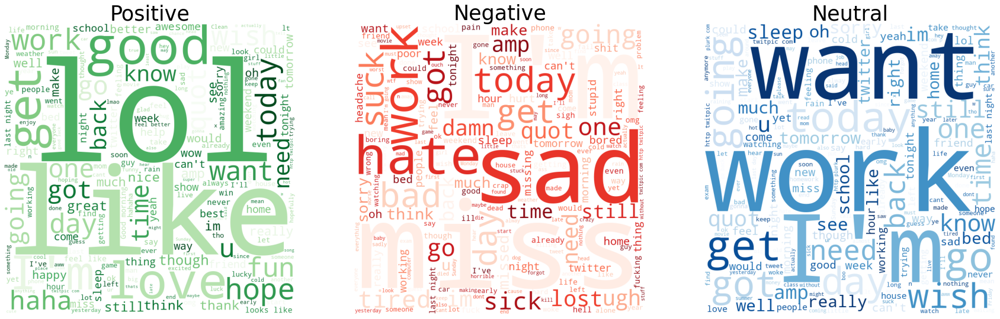

In [85]:
df_1 = df[df['Polaridad'] == 'positive']
df_2 = df[df['Polaridad'] == 'negative']
df_3 = df[df['Polaridad'] == 'neutral']

fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=[30, 15])
stopwords = set(STOPWORDS)

comment_words = '' 
for val in df_1['Texto']: 
    tokens = str(val).split()
    comment_words += " ".join(tokens)+" "
   
wordcloud1 = WordCloud(width = 800, height = 800, 
                background_color ='white',
                colormap="Greens",
                stopwords = stopwords, 
                min_font_size = 10).generate(comment_words) 

ax1.imshow(wordcloud1)
ax1.axis('off')
ax1.set_title('Positive', fontsize=35);

comment_words = ''
for val in df_2['Texto']: 
    tokens = str(val).split()  
    comment_words += " ".join(tokens)+" "

wordcloud2 = WordCloud(width = 800, height = 800, 
                background_color ='white',
                colormap="Reds",
                stopwords = stopwords, 
                min_font_size = 10).generate(comment_words)  
ax2.imshow(wordcloud2)
ax2.axis('off')
ax2.set_title('Negative', fontsize=35);

comment_words = ''
for val in df_3['Texto']: 
    tokens = str(val).split() 
    comment_words += " ".join(tokens)+" "

wordcloud3 = WordCloud(width = 800, height = 800, 
                background_color ='white',
                colormap="Blues",
                stopwords = stopwords, 
                min_font_size = 10).generate(comment_words) 
ax3.imshow(wordcloud3)
ax3.axis('off')
ax3.set_title('Neutral', fontsize=35);

#### 7. Alrededor de ciertas temáticas se generan conversaciones interesantes. Realiza una visualización agregada de la polaridad de las conversaciones para cada una de las palabras “kindle” y “sleep”.

In [86]:
set_dict = set()

def text_clean(text):
    #quitamos acentos
    text = unidecode(text)
    #removemos lo que no son palabras, es decir simbolos y demás
    text = re.sub("[^a-zA-Z]", " ", text)
    #ponemos en minúsculas
    text = text.lower()
    #tokenizamos (ponemos una lista de palabras igual que split)
    text = word_tokenize(text)
    #almacenamos en un diccionario
    [set_dict.add(palabra) for palabra in text]
    #contamos
    return len(text)

In [87]:
#nos la cuenta por fila de cada palabra
df['Numero_palabras_clean'] = df.Texto.map(text_clean) 

In [88]:
#nos la cuenta cada palabra elegida por fila del Dataset 
df['Total sleep'] = df.Texto.str.count("kindle") #cambiar por sleep 
df['Total kindle'] = df.Texto.str.count("sleep") #cambiar por kindle

df.head()

,Id del tweet,Fecha del tweet,Búsqueda,Usuario,Texto,Scores,Polaridad,Legibilidad,Entendible,Numero_frases,Numero_palabras,lectura,Nivel de grado,Numero_palabras_clean,Total sleep,Total kindle
0,1467810369,Mon Apr 06 22:19:45 PDT 2009,NO_QUERY,_TheSpecialOne_,"@switchfoot http://twitpic.com/2y1zl - Awww, t...",-2.0000,negative,13.7300,No entendible,2,18,8.2000,7º grado,23,0,0
1,1467810672,Mon Apr 06 22:19:49 PDT 2009,NO_QUERY,scotthamilton,is upset that he can't update his Facebook by ...,-5.0000,negative,7.9200,No entendible,2,21,4.0000,3er grado,22,0,0
2,1467810917,Mon Apr 06 22:19:53 PDT 2009,NO_QUERY,mattycus,@Kenichan I dived many times for the ball. Man...,2.0000,positive,9.3500,No entendible,2,18,1.6000,1er grado,17,0,0
3,1467811184,Mon Apr 06 22:19:57 PDT 2009,NO_QUERY,ElleCTF,my whole body feels itchy and like its on fire,-2.0000,negative,7.2900,No entendible,1,10,1.0000,Jardín de infancia,10,0,0
4,1467811193,Mon Apr 06 22:19:57 PDT 2009,NO_QUERY,Karoli,"@nationwideclass no, it's not behaving at all....",-4.0000,negative,5.4900,No entendible,3,21,2.3000,1er grado,24,0,0


Comparación mediante barplot de las palabras kindle y sleep:


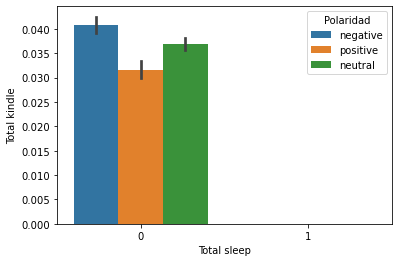

<AxesSubplot:xlabel='Total kindle', ylabel='Total sleep'>

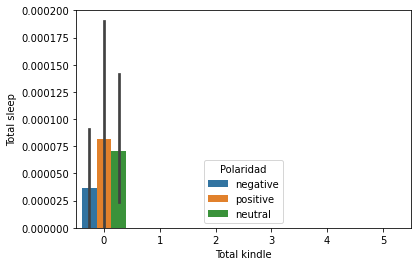

In [89]:
# Comparación mediante barplot de las palabras kindle y sleep
print("Comparación mediante barplot de las palabras kindle y sleep:")
sns.barplot( x= 'Total sleep', y = 'Total kindle',  hue= 'Polaridad' , data = df)
plt.show()
sns.barplot( x= 'Total kindle', y = 'Total sleep',  hue= 'Polaridad' , data = df)

#### 8. Muestra la media de legibilidad de los usuarios más citados según quartiles.

In [90]:
df_legibilidad = df.iloc[:, [0,3,4,7]]
df_legibilidad

,Id del tweet,Usuario,Texto,Legibilidad
0,1467810369,_TheSpecialOne_,"@switchfoot http://twitpic.com/2y1zl - Awww, t...",13.7300
1,1467810672,scotthamilton,is upset that he can't update his Facebook by ...,7.9200
2,1467810917,mattycus,@Kenichan I dived many times for the ball. Man...,9.3500
3,1467811184,ElleCTF,my whole body feels itchy and like its on fire,7.2900
4,1467811193,Karoli,"@nationwideclass no, it's not behaving at all....",5.4900
...,...,...,...,...
182568,1967185119,JoeMacsOlivia,@TaliaRusso miss you too sugar!! I have to wo...,7.5900
182569,1967185133,thesexypanther,on the road,0.1500
182570,1967185275,stephenmillet,..omg my dad just got a legit job offer from A...,8.9700
182571,1967185395,jwo_1013,getting sick but missing stunting on the mats...,10.5600


In [91]:
def count_hashtags (string): 
    words = string.split() #separa palabras e incluye en array
    hashtags = [word for word in words if word.startswith('#')] # Crea una lista de palabras hashtags. 
    return(len(hashtags)) # Devuelve el tamaño del Hastags

def MencionH(string):
    words = string.split() #separa palabras e incluye en array
    mentions = [word for word in words if word.startswith('@')] # Crea una lista de palabras hashtags. 
    return(mentions) #regresa el número de menciones

def count_mentions(string):
    words = string.split() #separa palabras e incluye en array
    mentions = [word for word in words if word.startswith('@')] # Crea una lista de palabras hashtags. 
    return (len(mentions)) #regresa el número de menciones


# Crear una función hashtag_count y mostrar los 
df_legibilidad['recuento_hashtag'] = df_legibilidad['Texto'].apply(count_hashtags)

df_legibilidad['mencion_influencer'] = df_legibilidad['Texto'].apply(MencionH)

# Create a feature mention_count and display distribution
df_legibilidad['recuento_mencion'] = df_legibilidad['Texto'].apply(count_mentions)

df_legibilidad = df_legibilidad.drop(df_legibilidad[df_legibilidad['recuento_mencion'] ==0].index)# Elimina registros sin menciones
df_legibilidad=df_legibilidad.sort_values('recuento_mencion',ascending= False) # Ordena de mayor a menor

Mencion_usuario = df_legibilidad.explode(column='mencion_influencer') # se linealiza el array de la columna Mencion

Mencion_usuario.head(10)

,Id del tweet,Usuario,Texto,Legibilidad,recuento_hashtag,mencion_influencer,recuento_mencion
143677,1881783563,trrs,12 twed twoses for you to enjoy... @-)-- @-)--...,8.5000,0,@-)--,12
143677,1881783563,trrs,12 twed twoses for you to enjoy... @-)-- @-)--...,8.5000,0,@-)--,12
143677,1881783563,trrs,12 twed twoses for you to enjoy... @-)-- @-)--...,8.5000,0,@-)--,12
143677,1881783563,trrs,12 twed twoses for you to enjoy... @-)-- @-)--...,8.5000,0,@-)--,12
143677,1881783563,trrs,12 twed twoses for you to enjoy... @-)-- @-)--...,8.5000,0,@-)--,12
143677,1881783563,trrs,12 twed twoses for you to enjoy... @-)-- @-)--...,8.5000,0,@-)--,12
143677,1881783563,trrs,12 twed twoses for you to enjoy... @-)-- @-)--...,8.5000,0,@-)--,12
143677,1881783563,trrs,12 twed twoses for you to enjoy... @-)-- @-)--...,8.5000,0,@-)--,12
143677,1881783563,trrs,12 twed twoses for you to enjoy... @-)-- @-)--...,8.5000,0,@-)--,12
143677,1881783563,trrs,12 twed twoses for you to enjoy... @-)-- @-)--...,8.5000,0,@-)--,12


In [92]:
df_legi = Mencion_usuario.groupby(by=['mencion_influencer'])['Legibilidad'].mean()

df_legi_por_usuario = pd.concat([df_influencers, df_legi], axis=1)
df_legi_por_usuario.head(10)

,Usuario,Legibilidad
@tommcfly,294,9.3546
@mileycyrus,291,9.4829
@ddlovato,204,9.5028
@DavidArchie,140,9.3776
@DonnieWahlberg,102,8.6811
@mitchelmusso,99,8.8995
@jordanknight,91,9.2292
@stephenfry,91,9.7279
@petewentz,78,8.9262
@nick_carter,73,9.6666


Ejecutar con todos los datos y ver la legibilidad de los más famosos

In [93]:
for i in df_legi_por_usuario.index[0:5]:
    print(i)

@tommcfly
@mileycyrus
@ddlovato
@DavidArchie
@DonnieWahlberg


In [94]:
df[df['Usuario']=="Dan_Schwartz"]['Legibilidad'].describe()

count    7.0000
mean    10.7071
std      3.1573
min      5.6100
25%      9.5100
50%      9.9700
75%     12.3600
max     15.6300
Name: Legibilidad, dtype: float64